In [76]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

In [77]:
df = pd.read_csv('Data\cars_price.csv', index_col=0)
df.head()

,make,model,priceUSD,year,condition,mileage(kilometers),fuel_type,volume(cm3),color,transmission,drive_unit,segment
0,honda,accord,565,1993,with mileage,960015.0,petrol,2000.0,black,mechanics,front-wheel drive,D
1,ford,fusion,5550,2008,with mileage,172000.0,diesel,1400.0,silver,mechanics,front-wheel drive,M
2,nissan,teana,8300,2008,with mileage,223000.0,petrol,2500.0,purple,auto,front-wheel drive,D
3,volkswagen,fox,3300,2005,with mileage,140000.0,petrol,1200.0,blue,mechanics,front-wheel drive,A
4,nissan,primera,2450,2002,with damage,413000.0,diesel,2200.0,burgundy,mechanics,front-wheel drive,D


In [78]:
import pandas_profiling as pp

In [79]:
pp.ProfileReport(df)

Render HTML: 100%|██████████| 1/1 [00:00<00:00,  1.12it/s]


Since the Make and model have very high Cardinality we'll not be consider for model training.

In [80]:
def details(df):
  print("Description of training set")
  print("Shape: \t\t\t", df.shape)
  print("#NaNs: \t\t\t", df.isna().sum().sum()) 
  
details(df)

Description of training set
Shape: 			 (40000, 12)
#NaNs: 			 5130


In [81]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 40000 entries, 0 to 39999
Data columns (total 12 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   make                 40000 non-null  object 
 1   model                40000 non-null  object 
 2   priceUSD             40000 non-null  int64  
 3   year                 40000 non-null  int64  
 4   condition            40000 non-null  object 
 5   mileage(kilometers)  40000 non-null  float64
 6   fuel_type            40000 non-null  object 
 7   volume(cm3)          39970 non-null  float64
 8   color                40000 non-null  object 
 9   transmission         40000 non-null  object 
 10  drive_unit           38655 non-null  object 
 11  segment              36245 non-null  object 
dtypes: float64(2), int64(2), object(8)
memory usage: 4.0+ MB


In [82]:
# Columns containing NAN
def ctd(df):
  columns = df.columns[df.isna().any()].tolist()
  return columns
ctd(df)

['volume(cm3)', 'drive_unit', 'segment']

In [83]:
df.dropna(inplace=True)
details(df)

Description of training set
Shape: 			 (35016, 12)
#NaNs: 			 0


In [84]:
import datetime
df['year']=datetime.datetime.now().year-df['year']
df.head()

,make,model,priceUSD,year,condition,mileage(kilometers),fuel_type,volume(cm3),color,transmission,drive_unit,segment
0,honda,accord,565,27,with mileage,960015.0,petrol,2000.0,black,mechanics,front-wheel drive,D
1,ford,fusion,5550,12,with mileage,172000.0,diesel,1400.0,silver,mechanics,front-wheel drive,M
2,nissan,teana,8300,12,with mileage,223000.0,petrol,2500.0,purple,auto,front-wheel drive,D
3,volkswagen,fox,3300,15,with mileage,140000.0,petrol,1200.0,blue,mechanics,front-wheel drive,A
4,nissan,primera,2450,18,with damage,413000.0,diesel,2200.0,burgundy,mechanics,front-wheel drive,D


In [85]:
def description(df):
  for cols in df.columns:
    print('Unique values for ',cols,' : ',len(df[cols].unique()))
description(df)

Unique values for  make  :  51
Unique values for  model  :  458
Unique values for  priceUSD  :  2328
Unique values for  year  :  62
Unique values for  condition  :  3
Unique values for  mileage(kilometers)  :  5755
Unique values for  fuel_type  :  2
Unique values for  volume(cm3)  :  352
Unique values for  color  :  13
Unique values for  transmission  :  2
Unique values for  drive_unit  :  4
Unique values for  segment  :  9


In [86]:
df.columns

Index(['make', 'model', 'priceUSD', 'year', 'condition', 'mileage(kilometers)',
       'fuel_type', 'volume(cm3)', 'color', 'transmission', 'drive_unit',
       'segment'],
      dtype='object')

In [87]:
categorical = ['make', 'model',  'condition',
       'fuel_type', 'color', 'transmission', 'drive_unit','segment']
numerical = ['priceUSD','year','mileage(kilometers)','volume(cm3)']

# Plots

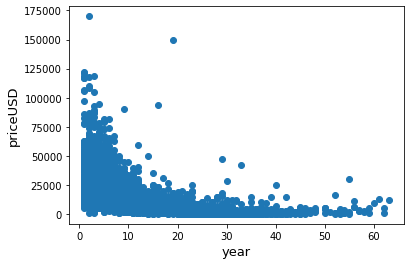

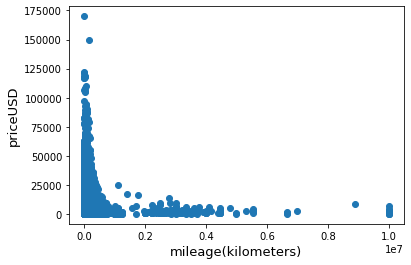

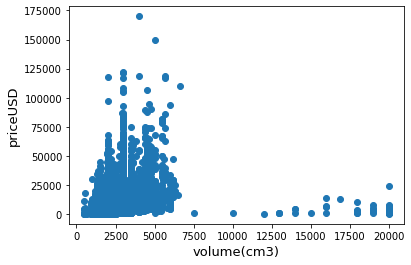

In [88]:
for cols in ['year','mileage(kilometers)','volume(cm3)']:
    fig, ax = plt.subplots()
    ax.scatter(x = df[cols] ,y = df['priceUSD'])
    plt.ylabel('priceUSD', fontsize=13)
    plt.xlabel(str(cols), fontsize=13)
    plt.show()

## Ouliers

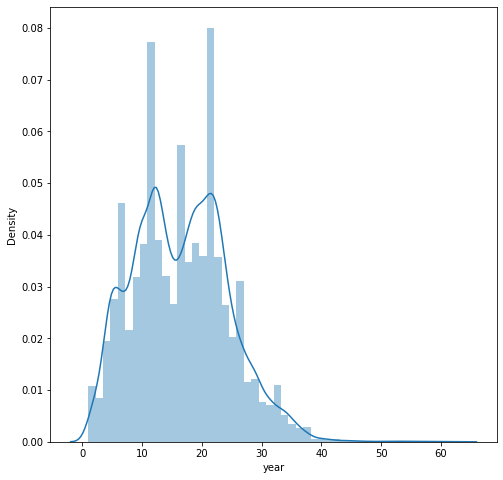

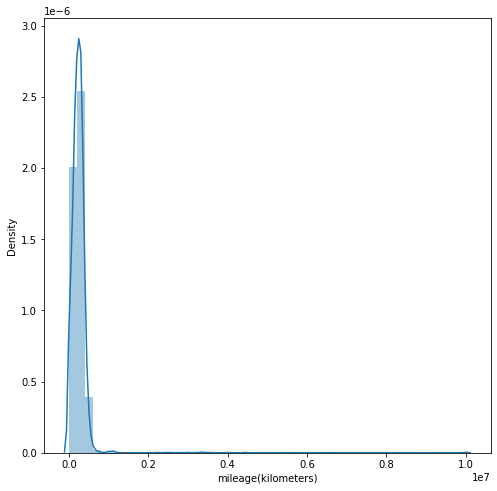

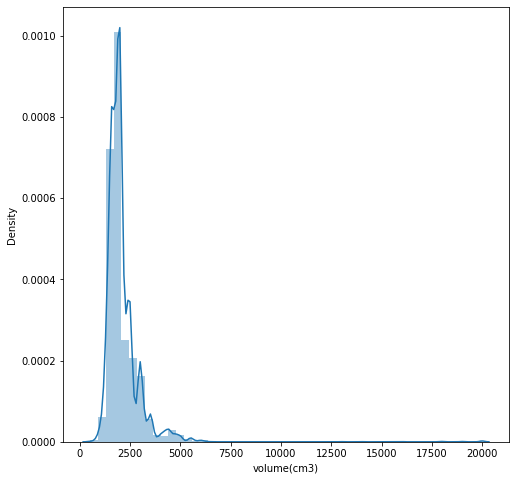

In [89]:
def anomaly_plot(df,anaomaly_cols):
  for cols in anaomaly_cols:
    plt.figure(figsize=(8, 8))
    sns.distplot(df[cols])
anomaly_plot(df,['year','mileage(kilometers)','volume(cm3)'])

In [90]:
anomaly_dict = {
    'year': 36,
    'mileage(kilometers)': 0.8e7,
    'volume(cm3)': 3700
}


In [91]:
def outlier_removal(df,dict):
  for key, value in dict.items():
    df = df[df[key] < value]
  return df

In [92]:
df = outlier_removal(df3,anomaly_dict)
df.dropna(inplace=True)
details(df)
df.info()

Description of training set
Shape: 			 (33354, 12)
#NaNs: 			 0
<class 'pandas.core.frame.DataFrame'>
Int64Index: 33354 entries, 0 to 39999
Data columns (total 12 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   make                 33354 non-null  object 
 1   model                33354 non-null  object 
 2   priceUSD             33354 non-null  int64  
 3   year                 33354 non-null  int64  
 4   condition            33354 non-null  object 
 5   mileage(kilometers)  33354 non-null  float64
 6   fuel_type            33354 non-null  object 
 7   volume(cm3)          33354 non-null  float64
 8   color                33354 non-null  object 
 9   transmission         33354 non-null  object 
 10  drive_unit           33354 non-null  object 
 11  segment              33354 non-null  object 
dtypes: float64(2), int64(2), object(8)
memory usage: 3.3+ MB


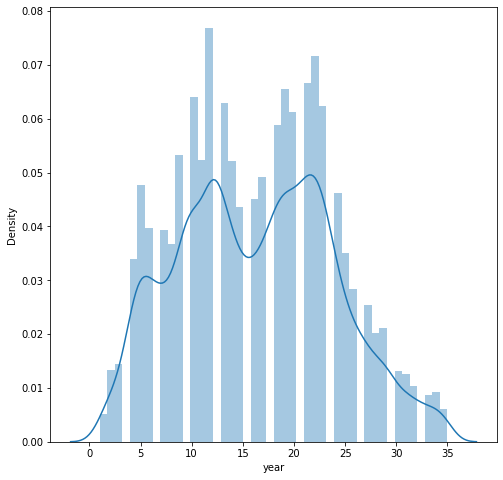

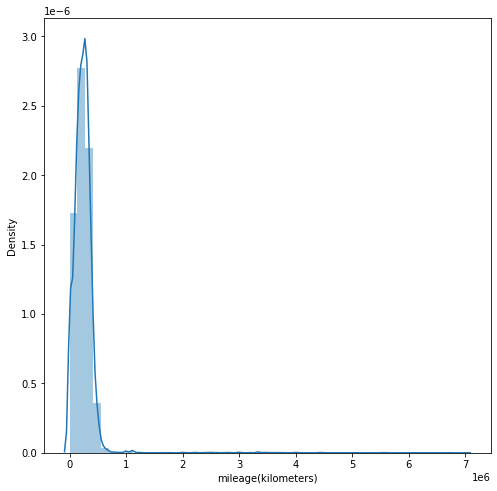

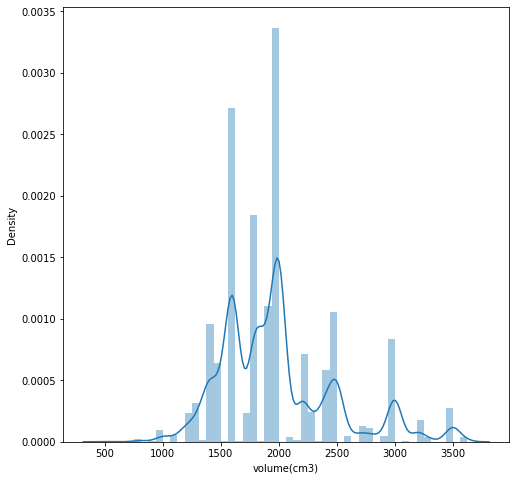

In [93]:
anomaly_plot(df,['year','mileage(kilometers)','volume(cm3)'])

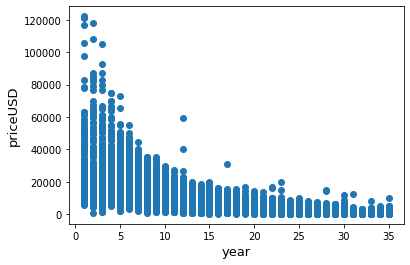

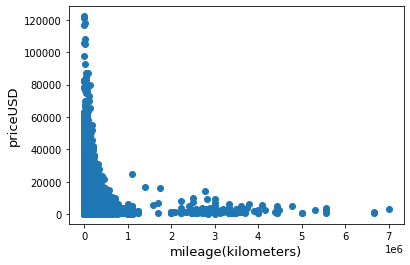

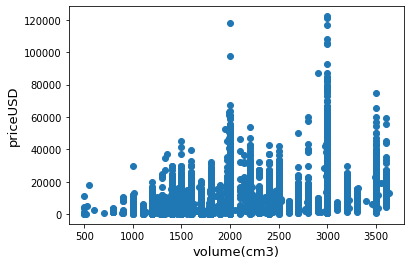

In [94]:
for cols in ['year','mileage(kilometers)','volume(cm3)']:
    fig, ax = plt.subplots()
    ax.scatter(x = df[cols] ,y = df['priceUSD'])
    plt.ylabel('priceUSD', fontsize=13)
    plt.xlabel(str(cols), fontsize=13)
    plt.show()

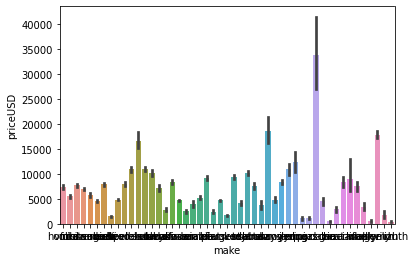

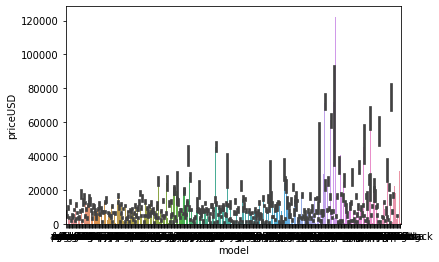

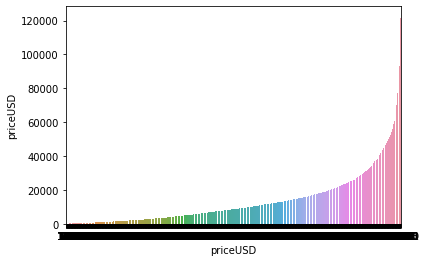

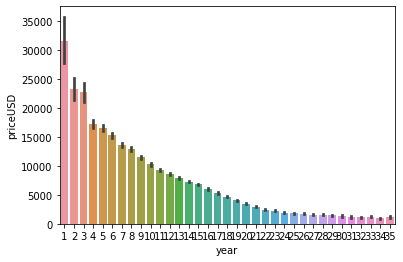

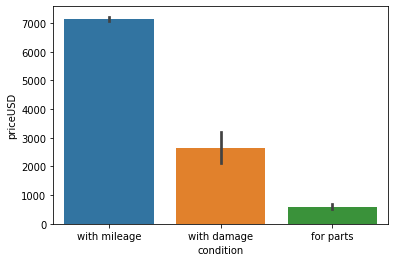

...

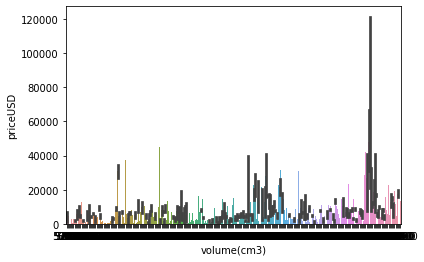

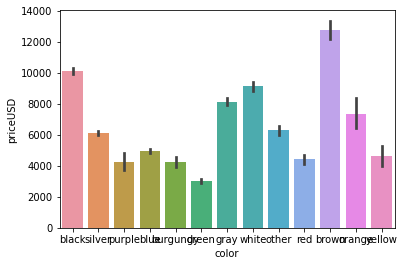

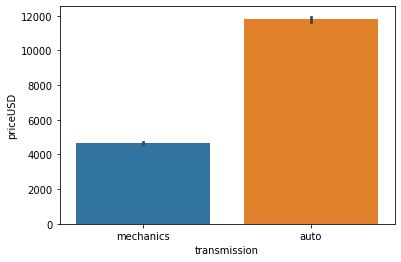

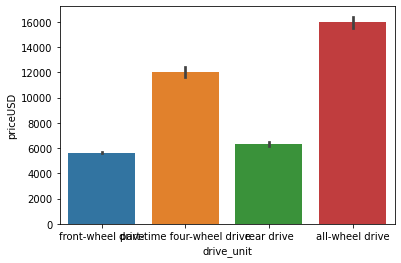

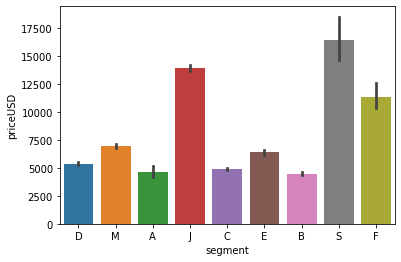

In [95]:
for cols in df.columns:
    sns.barplot(x=str(cols), y='priceUSD', data=df)
    plt.show()

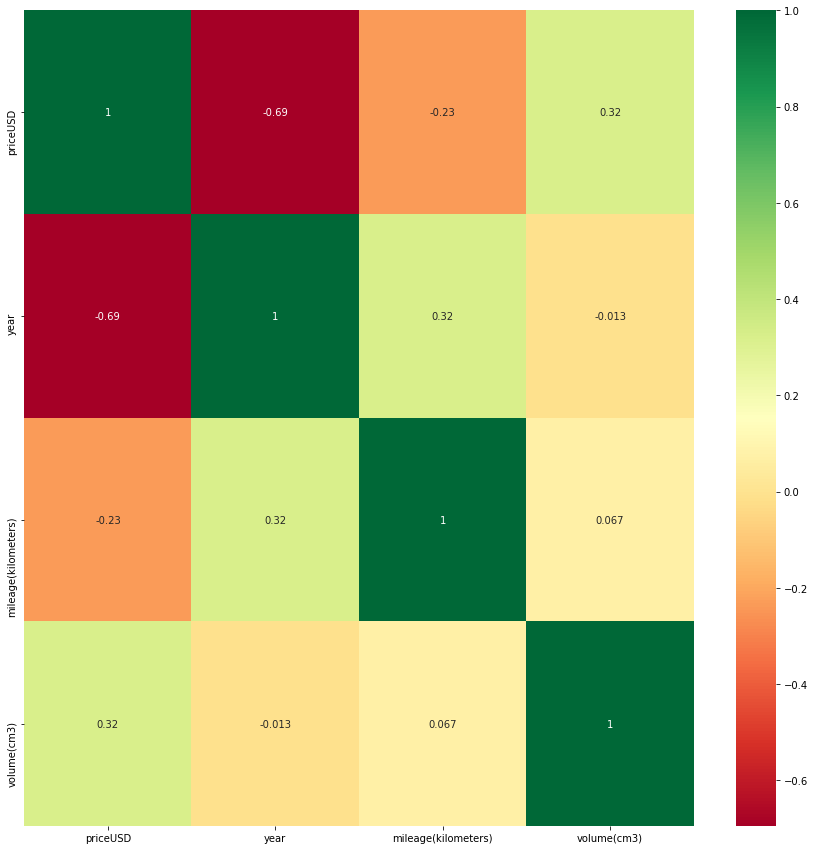

In [96]:
#Correlation map to see how features are correlated with SalePrice
#get correlations of each features in dataset
corrmat = df.corr()
top_corr_features = corrmat.index
plt.figure(figsize=(15,15))
#plot heat map
g=sns.heatmap(df[top_corr_features].corr(),annot=True,cmap="RdYlGn")

In [71]:
df.shape

(33354, 12)

## Model

In [97]:
features =[ 'year', 'condition', 'mileage(kilometers)',
       'fuel_type', 'volume(cm3)', 'color', 'transmission', 'drive_unit',
       'segment']
categorical = ['condition',
       'fuel_type', 'color', 'transmission', 'drive_unit','segment']
numerical = ['priceUSD','year','mileage(kilometers)','volume(cm3)']

In [98]:
from sklearn.preprocessing import LabelEncoder

In [99]:
def mappings(df,categorical):
  label = LabelEncoder()
  df2= df
  dictionaries = []
  for feature in categorical:
    label.fit(df[feature])
    le_name_mapping = dict(zip(label.classes_, label.transform(label.classes_)))
    dictionaries.append(le_name_mapping)
    # print(le_name_mapping)
  return dictionaries
dictionaries = mappings(df,categorical)
dictionaries[1]

{'diesel': 0, 'petrol': 1}

In [100]:
def encoding(df,categorical):
  label = LabelEncoder()
  df2= df
  for feature in categorical:
    df2[feature] =label.fit_transform(df[feature])
  return df2

In [132]:
df.shape

(33354, 12)

In [133]:
dataset = encoding(df,categorical)
dataset.head()

,make,model,priceUSD,year,condition,mileage(kilometers),fuel_type,volume(cm3),color,transmission,drive_unit,segment
0,honda,accord,565,27,2,960015.0,1,2000.0,0,1,1,3
1,ford,fusion,5550,12,2,172000.0,0,1400.0,10,1,1,7
2,nissan,teana,8300,12,2,223000.0,1,2500.0,8,0,1,3
3,volkswagen,fox,3300,15,2,140000.0,1,1200.0,1,1,1,0
4,nissan,primera,2450,18,1,413000.0,0,2200.0,3,1,1,3


In [134]:
target = df['priceUSD']
dataset = pd.DataFrame(data=dataset[features],columns=features)
target.shape, dataset.shape

((33354,), (33354, 9))

In [135]:
print(dataset.shape)
dataset.head()

(33354, 9)


,year,condition,mileage(kilometers),fuel_type,volume(cm3),color,transmission,drive_unit,segment
0,27,2,960015.0,1,2000.0,0,1,1,3
1,12,2,172000.0,0,1400.0,10,1,1,7
2,12,2,223000.0,1,2500.0,8,0,1,3
3,15,2,140000.0,1,1200.0,1,1,1,0
4,18,1,413000.0,0,2200.0,3,1,1,3


In [136]:
from sklearn.preprocessing import MinMaxScaler

In [137]:
def normalize(df,features):
  mms = MinMaxScaler(feature_range=(0,10))
  df[features] = mms.fit_transform(df[features])
  return df

In [138]:
df2 = dataset

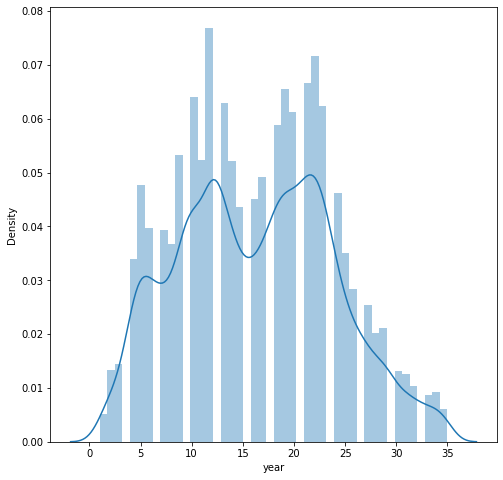

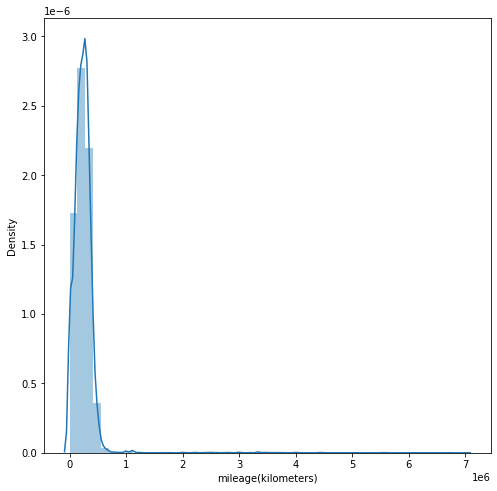

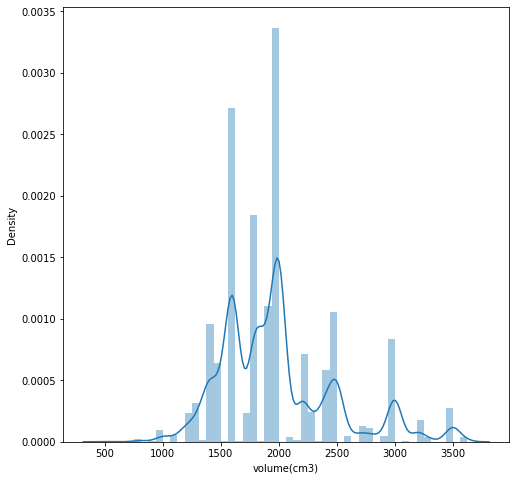

In [139]:
anomaly_plot(dataset,['year','mileage(kilometers)','volume(cm3)'])

In [140]:
data = normalize(df2,['year','mileage(kilometers)','volume(cm3)'])
data

,year,condition,mileage(kilometers),fuel_type,volume(cm3),color,transmission,drive_unit,segment
0,7.647059,2,1.371450,1,4.795396,0,1,1,3
1,3.235294,2,0.245714,0,2.877238,10,1,1,7
2,3.235294,2,0.318571,1,6.393862,8,0,1,3
3,4.117647,2,0.200000,1,2.237852,1,1,1,0
4,5.000000,1,0.590000,0,5.434783,3,1,1,3
...,...,...,...,...,...,...,...,...,...
39993,1.176471,2,0.167143,0,3.516624,11,1,1,7
39994,3.235294,2,0.397143,0,4.795396,1,1,1,3
39996,5.294118,2,0.421429,1,5.434783,1,1,1,4
39997,5.882353,2,0.000000,0,5.434783,7,1,3,3


In [141]:
from sklearn.model_selection import train_test_split

In [142]:
X_train, X_test, y_train, y_test = train_test_split(data,target, test_size=0.10, random_state=42)
X_train.shape, y_train.shape, X_test.shape,  y_test.shape

((30018, 9), (30018,), (3336, 9), (3336,))

In [143]:
from xgboost import XGBRegressor

In [364]:
XGB = XGBRegressor(max_depth=3,learning_rate=0.2,n_estimators=500,reg_alpha=0.001,reg_lambda=0.001,n_jobs=-1,min_child_weight=3)
XGB.fit(X_train,y_train)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.2, max_delta_step=0, max_depth=3,
             min_child_weight=3, missing=nan, monotone_constraints='()',
             n_estimators=500, n_jobs=-1, num_parallel_tree=1,
             objective='reg:squarederror', random_state=0, reg_alpha=0.001,
             reg_lambda=0.001, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [365]:
print ("Training score:",XGB.score(X_train,y_train),"Test Score:",XGB.score(X_test,y_test))

Training score: 0.9294877393251957 Test Score: 0.873341367413035


In [366]:
y_test_pred = XGB.predict(X_test)
y_test_pred

array([2509.3967 ,  628.56036, 2149.9604 , ..., 6845.018  , 1339.0609 ,
       2534.1409 ], dtype=float32)

In [367]:
dictionary = {
    'year':[4.193548387096774],
     'condition':[2],
      'mileage(kilometers)':[0.9600150960015096],
       'fuel_type':[1],
        'volume(cm3)':[0.7692307692307693],
         'color':[0],
          'transmission':[1],
           'drive_unit':[1],
            'segment':[3]
}
test = pd.DataFrame(data=dictionary)
test

,year,condition,mileage(kilometers),fuel_type,volume(cm3),color,transmission,drive_unit,segment
0,4.193548,2,0.960015,1,0.769231,0,1,1,3


In [374]:
print(XGB.predict(test)[0])

5879.2783


In [375]:
import pickle

In [376]:
pickle.dump(XGB, open('model.pkl','wb'))

In [377]:
dictionaries

[{'for parts': 0, 'with damage': 1, 'with mileage': 2},
 {'diesel': 0, 'petrol': 1},
 {'black': 0,
  'blue': 1,
  'brown': 2,
  'burgundy': 3,
  'gray': 4,
  'green': 5,
  'orange': 6,
  'other': 7,
  'purple': 8,
  'red': 9,
  'silver': 10,
  'white': 11,
  'yellow': 12},
 {'auto': 0, 'mechanics': 1},
 {'all-wheel drive': 0,
  'front-wheel drive': 1,
  'part-time four-wheel drive': 2,
  'rear drive': 3},
 {'A': 0, 'B': 1, 'C': 2, 'D': 3, 'E': 4, 'F': 5, 'J': 6, 'M': 7, 'S': 8}]